# EU Elections 2019, Italy
## Introduction
In this analysis using **pdnd-nteract** we will present some data, in chart and map forms, regarding the [**polls of the 2019 EU elections in Italy**](https://github.com/giocomai/elezioni_europee_2019_italia_csv/tree/master/scrutini).

The dataset is published by the Ministero dell'Interno and it contains the polls divided by party and town/polling station.

## Let's start

We will start by importing some python libraries:

In [1]:
import requests
import pandas as pd
import geopandas as gpd
import matplotlib
import matplotlib.pyplot as plt
from io import StringIO
pd.options.display.html.table_schema = True
pd.set_option('display.max_rows', None)
import os

In [2]:
df = pd.read_csv(os.path.join('scrutini', 'scrutini_comuni_full.csv'))
df.head(20)

,pos,desc_lis,img_lis,min,max_coll,voti,perc,area,circ_sto,cod_com,...,sk_contestate,sk_nulle,st,sz_perv,sz_tot,t_ele,tot_vot_lis,vot_f,vot_m,vot_t
0,12,PARTITO DEMOCRATICO,1-20190526000000-12.png,N,NaN,1904,"31,07",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
1,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,1809,"29,52",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
2,8,MOVIMENTO 5 STELLE,1-20190526000000-8.png,N,NaN,969,"15,81",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
3,11,FORZA ITALIA,1-20190526000000-11.png,N,NaN,415,"6,77",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
4,7,FRATELLI D'ITALIA,1-20190526000000-7.png,N,NaN,350,"5,71",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
5,1,+EUROPA - ITALIA IN COMUNE - PDE ITALIA,1-20190526000000-1.png,N,NaN,236,"3,85",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
6,16,EUROPA VERDE,1-20190526000000-16.png,N,NaN,150,"2,45",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
7,18,LA SINISTRA,1-20190526000000-18.png,N,NaN,115,"1,88",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
8,2,PARTITO COMUNISTA,1-20190526000000-2.png,N,NaN,60,"0,98",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
9,4,PARTITO ANIMALISTA,1-20190526000000-4.png,N,NaN,33,"0,54",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252


In [3]:
list(df)

['pos',
 'desc_lis',
 'img_lis',
 'min',
 'max_coll',
 'voti',
 'perc',
 'area',
 'circ_sto',
 'cod_com',
 'cod_prov',
 'comu_sto',
 'data_prec_elez',
 'desc_com',
 'desc_prov',
 'dt_agg',
 'dt_ele',
 'ele_f',
 'ele_m',
 'ele_t',
 'f_elet',
 'fine_rip',
 'l_terr',
 'non_valid',
 'perc_vot',
 'prov_sto',
 'reg_sto',
 'sk_bianche',
 'sk_contestate',
 'sk_nulle',
 'st',
 'sz_perv',
 'sz_tot',
 't_ele',
 'tot_vot_lis',
 'vot_f',
 'vot_m',
 'vot_t']

In [4]:
df['desc_com'].unique().size

7909

In [5]:
df['desc_lis'].unique()

array(['PARTITO DEMOCRATICO', 'LEGA SALVINI PREMIER',
       'MOVIMENTO 5 STELLE', 'FORZA ITALIA', "FRATELLI D'ITALIA",
       '+EUROPA - ITALIA IN COMUNE - PDE ITALIA', 'EUROPA VERDE',
       'LA SINISTRA', 'PARTITO COMUNISTA', 'PARTITO ANIMALISTA',
       'POPOLO DELLA FAMIGLIA - ALTERNATIVA POPOLARE',
       "POPOLARI PER L'ITALIA", 'PARTITO PIRATA',
       "AUTONOMIE PER L'EUROPA", 'CASAPOUND ITALIA - DESTRE UNITE',
       'FORZA NUOVA', 'PPA MOVIMENTO POLITICO PENSIERO AZIONE', 'SVP'],
      dtype=object)

Here we can see a *bar chart* of the total votes for each party

In [6]:
votes_by_party = df.groupby(['desc_lis'])[['voti']].sum()
votes_by_party

,voti
desc_lis,
+EUROPA - ITALIA IN COMUNE - PDE ITALIA,822764
AUTONOMIE PER L'EUROPA,17629
CASAPOUND ITALIA - DESTRE UNITE,88724
EUROPA VERDE,609678
FORZA ITALIA,2344465
FORZA NUOVA,40782
FRATELLI D'ITALIA,1723232
LA SINISTRA,465092
LEGA SALVINI PREMIER,9153638


In [7]:
highest_party_by_com = df.drop_duplicates(subset='desc_com', keep="first")
highest_party_by_com

,pos,desc_lis,img_lis,min,max_coll,voti,perc,area,circ_sto,cod_com,...,sk_contestate,sk_nulle,st,sz_perv,sz_tot,t_ele,tot_vot_lis,vot_f,vot_m,vot_t
0,12,PARTITO DEMOCRATICO,1-20190526000000-12.png,N,NaN,1904,"31,07",I,1.0,10,...,0,80,ESERCIZIO,10,10,Europee,6129,3228,3024,6252
16,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,639,"42,77",I,1.0,20,...,0,28,ESERCIZIO,3,3,Europee,1494,783,776,1559
32,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,536,"36,61",I,1.0,30,...,0,36,ESERCIZIO,4,4,Europee,1464,720,817,1537
48,12,PARTITO DEMOCRATICO,1-20190526000000-12.png,N,NaN,676,"30,41",I,1.0,40,...,0,25,ESERCIZIO,4,4,Europee,2223,1177,1086,2263
64,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,453,"46,85",I,1.0,50,...,0,40,ESERCIZIO,4,4,Europee,967,503,547,1050
80,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,1066,"35,38",I,1.0,60,...,0,79,ESERCIZIO,7,7,Europee,3013,1583,1561,3144
96,12,PARTITO DEMOCRATICO,1-20190526000000-12.png,N,NaN,907,"31,97",I,1.0,70,...,0,35,ESERCIZIO,7,7,Europee,2837,1429,1454,2883
112,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,540,"31,73",I,1.0,80,...,0,45,ESERCIZIO,3,3,Europee,1702,894,910,1804
128,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,1144,"30,67",I,1.0,90,...,0,90,ESERCIZIO,9,9,Europee,3730,1963,1927,3890
144,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,750,"40,54",I,1.0,100,...,0,75,ESERCIZIO,4,4,Europee,1850,1014,974,1988


In [8]:
highest_party_by_com['desc_lis'].unique()

array(['PARTITO DEMOCRATICO', 'LEGA SALVINI PREMIER',
       'MOVIMENTO 5 STELLE', 'FORZA ITALIA', "AUTONOMIE PER L'EUROPA",
       'SVP', "FRATELLI D'ITALIA", "POPOLARI PER L'ITALIA", 'LA SINISTRA',
       'EUROPA VERDE', 'CASAPOUND ITALIA - DESTRE UNITE',
       '+EUROPA - ITALIA IN COMUNE - PDE ITALIA'], dtype=object)

In [9]:
len(highest_party_by_com)

7909

In [10]:
df = pd.read_csv(os.path.join('scrutini', 'scrutini_provincia_full.csv'))
df

,pos,desc_lis,img_lis,min,max_coll,voti,perc,area,circ_sto,cod_pr,...,sk_contestate,sk_nulle,st,sz_perv,sz_tot,t_ele,tot_vot_lis,vot_f,vot_m,vot_t
0,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,119817,"30,29",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
1,12,PARTITO DEMOCRATICO,1-20190526000000-12.png,N,NaN,109083,"27,58",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
2,8,MOVIMENTO 5 STELLE,1-20190526000000-8.png,N,NaN,69360,"17,53",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
3,11,FORZA ITALIA,1-20190526000000-11.png,N,NaN,28971,"7,32",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
4,7,FRATELLI D'ITALIA,1-20190526000000-7.png,N,NaN,21004,"5,31",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
5,1,+EUROPA - ITALIA IN COMUNE - PDE ITALIA,1-20190526000000-1.png,N,NaN,13666,"3,45",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
6,16,EUROPA VERDE,1-20190526000000-16.png,N,NaN,10618,"2,68",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
7,18,LA SINISTRA,1-20190526000000-18.png,N,NaN,9431,"2,38",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
8,2,PARTITO COMUNISTA,1-20190526000000-2.png,N,NaN,4924,"1,24",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
9,4,PARTITO ANIMALISTA,1-20190526000000-4.png,N,NaN,2715,"0,69",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924


In [11]:
highest_party_by_prov = df.drop_duplicates(subset='desc_pr', keep="first")
highest_party_by_prov

,pos,desc_lis,img_lis,min,max_coll,voti,perc,area,circ_sto,cod_pr,...,sk_contestate,sk_nulle,st,sz_perv,sz_tot,t_ele,tot_vot_lis,vot_f,vot_m,vot_t
0,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,119817,"30,29",I,1.0,34,...,34,7719,ESERCIZIO,966,966,Europee,395558,209926,196998,406924
16,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,39923,"40,06",I,1.0,37,...,6,2427,ESERCIZIO,256,256,Europee,99650,53767,50134,103901
32,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,36462,"34,85",I,1.0,39,...,2,2098,ESERCIZIO,260,260,Europee,104630,54441,53401,107842
48,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,55494,"38,79",I,1.0,74,...,1,3592,ESERCIZIO,309,309,Europee,143077,76774,72153,148927
64,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,296354,"51,11",I,1.0,12,...,56,10384,ESERCIZIO,968,968,Europee,579830,301815,296252,598067
80,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,319278,"49,59",I,1.0,15,...,11,10468,ESERCIZIO,1170,1170,Europee,643829,334276,328935,663211
96,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,145480,"48,33",I,1.0,24,...,18,6404,ESERCIZIO,551,551,Europee,301012,157776,153471,311247
112,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,86705,"46,49",I,1.0,26,...,5,3755,ESERCIZIO,405,405,Europee,186520,97599,95935,193534
128,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,78223,"45,12",I,1.0,98,...,8,3565,ESERCIZIO,316,316,Europee,173351,90449,88853,179302
144,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,51505,"45,82",I,1.0,99,...,18,2413,ESERCIZIO,220,220,Europee,112408,58493,57919,116412


In [12]:
len(highest_party_by_prov)

107

## Map representation

In [13]:
plt.rcParams['figure.dpi'] = 150

In [14]:
map_df = gpd.read_file(os.path.join('italy_maps','Com01012019_g','Com01012019_g_WGS84.shp'))
map_df.columns = ['desc_com' if x=='COMUNE' else x for x in map_df.columns]
map_df['desc_com'] = map_df['desc_com'].str.upper()

#map_df.head(20)

In [15]:
len(map_df)

7926

In [16]:
merged = pd.merge(map_df, highest_party_by_com, on='desc_com')
len(merged)

7643

In [17]:
map_pr = gpd.read_file(os.path.join('italy_maps','ProvCM01012019_g','ProvCM01012019_g_WGS84.shp'))
map_pr.columns = ['desc_pr' if x=='DEN_UTS' else x for x in map_pr.columns]
map_pr['desc_pr'] = map_pr['desc_pr'].str.upper()

map_pr.head(20)

TypeError: __init__() got an unexpected keyword argument 'orient'

,COD_RIP,COD_REG,COD_PROV,COD_CM,COD_UTS,DEN_PROV,DEN_CM,desc_pr,SIGLA,TIPO_UTS,Shape_Leng,Shape_Area,geometry
0,2,6,93,0,93,Pordenone,-,PORDENONE,PN,Unità non amministrativa,277744.673487,2.275459e+09,"POLYGON ((770721.5938999997 5143295.297, 77095..."
1,4,14,94,0,94,Isernia,-,ISERNIA,IS,Provincia,260963.457300,1.534487e+09,"POLYGON ((940185.6413000003 4651530.8827, 9402..."
2,1,1,96,0,96,Biella,-,BIELLA,BI,Provincia,158026.165333,9.124848e+08,"POLYGON ((432302.8777999999 5067417.858899999,..."
3,1,3,97,0,97,Lecco,-,LECCO,LC,Provincia,181294.401343,8.056511e+08,"POLYGON ((532079.6178000001 5104664.0919, 5332..."
4,1,3,98,0,98,Lodi,-,LODI,LO,Provincia,234944.113661,7.819878e+08,"POLYGON ((534551.9681000002 5035118.602600001,..."
5,2,8,99,0,99,Rimini,-,RIMINI,RN,Provincia,254852.639699,8.658280e+08,"POLYGON ((779573.5756999999 4891555.4366, 7801..."
6,3,9,100,0,100,Prato,-,PRATO,PO,Provincia,119039.650595,3.658274e+08,"POLYGON ((673895.9932000004 4886075.201199999,..."
7,4,18,101,0,101,Crotone,-,CROTONE,KR,Provincia,255379.678840,1.734212e+09,"POLYGON ((1193301.0595 4396651.8456, 1193357.4..."
8,4,18,102,0,102,Vibo Valentia,-,VIBO VALENTIA,VV,Provincia,202524.198570,1.148196e+09,"POLYGON ((1133745.1478 4322320.461999999, 1134..."
9,1,1,103,0,103,Verbano-Cusio-Ossola,-,VERBANO-CUSIO-OSSOLA,VB,Provincia,300316.961132,2.262145e+09,"POLYGON ((457749.4639999997 5145501.795399999,..."


In [18]:
len(map_pr)

107

In [19]:
highest_party_by_prov[~highest_party_by_prov['desc_pr'].isin(map_pr['desc_pr'])]

,pos,desc_lis,img_lis,min,max_coll,voti,perc,area,circ_sto,cod_pr,...,sk_contestate,sk_nulle,st,sz_perv,sz_tot,t_ele,tot_vot_lis,vot_f,vot_m,vot_t
519,12,PARTITO DEMOCRATICO,1-20190526000000-12.png,N,NaN,93394,"34,78",I,2.0,68,...,15,4835,ESERCIZIO,477,477,Europee,268512,139679,137277,276956
999,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,31769,"35,70",I,3.0,46,...,3,1809,ESERCIZIO,261,261,Europee,88982,46098,45482,91580
1239,5,LEGA SALVINI PREMIER,1-20190526000000-5.png,N,NaN,40361,"22,77",I,4.0,67,...,31,5931,ESERCIZIO,699,699,Europee,177217,90649,97229,187878


In [20]:
map_pr[~map_pr['desc_pr'].isin(highest_party_by_prov['desc_pr'])]

TypeError: __init__() got an unexpected keyword argument 'orient'

,COD_RIP,COD_REG,COD_PROV,COD_CM,COD_UTS,DEN_PROV,DEN_CM,desc_pr,SIGLA,TIPO_UTS,Shape_Leng,Shape_Area,geometry
47,2,8,35,0,35,Reggio nell'Emilia,-,REGGIO NELL'EMILIA,RE,Provincia,263144.938061,2.290401e+09,"POLYGON ((636319.3743000003 4982990.1895, 6363..."
57,3,9,45,0,45,Massa Carrara,-,MASSA CARRARA,MS,Provincia,203700.618771,1.154271e+09,"POLYGON ((572033.1078000003 4924393.436000001,..."
92,4,18,80,280,280,-,Reggio di Calabria,REGGIO DI CALABRIA,RC,Citta metropolitana,303452.008635,3.209238e+09,"POLYGON ((1145631.6269 4294410.270300001, 1146..."


In [21]:
map_pr['desc_pr'] = map_pr['desc_pr'].replace({"REGGIO NELL'EMILIA": "REGGIO NELL' EMILIA", 'MASSA CARRARA': 'MASSA-CARRARA', "REGGIO DI CALABRIA": "REGGIO CALABRIA"})

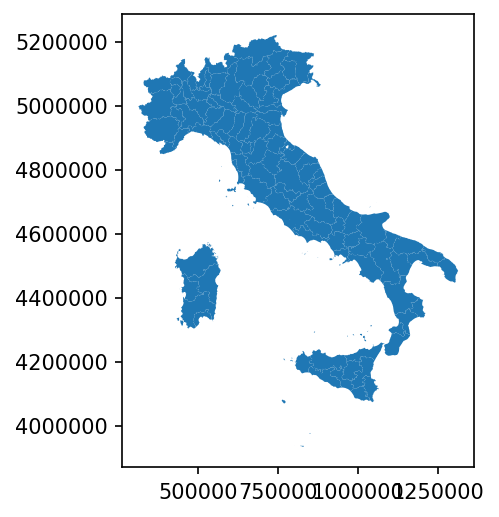

In [22]:
merged2 = pd.merge(map_pr, highest_party_by_prov, on='desc_pr')
merged2.plot()

In [ ]:
len(merged

In [36]:
merged_p1 = merged2[merged2['desc_lis'].isin(['LEGA SALVINI PREMIER'])]
merged_p2 = merged2[merged2['desc_lis'].isin(['PARTITO DEMOCRATICO'])]
merged_p3 = merged2[merged2['desc_lis'].isin(['MOVIMENTO 5 STELLE'])]
len(merged_p1)

76

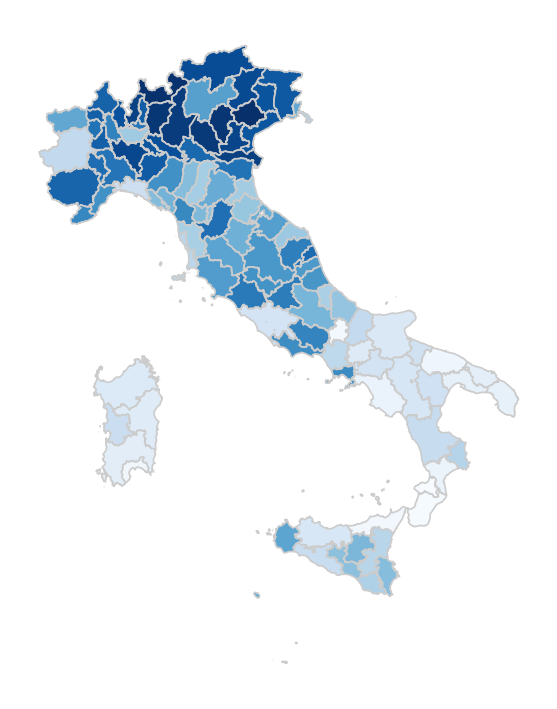

In [24]:
variable = 'perc'
vmin, vmax = 0, 425
fig, ax = plt.subplots(1, figsize=(10, 6))

ax.axis('off')

merged2.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')